In [1]:
import pandas as pd

import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

import nltk
#nltk.download()

import plotly
import plotly.graph_objs as go

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
plotly.offline.init_notebook_mode(connected=True)

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

import matplotlib.pyplot as plt
%matplotlib inline

from bokeh.io import output_file,show,output_notebook,push_notebook
from bokeh.plotting import figure
from bokeh.models import ColumnDataSource,HoverTool,CategoricalColorMapper
from bokeh.layouts import row,column,gridplot
from bokeh.models.widgets import Tabs,Panel
output_notebook()

Loading BokehJS ...

In [2]:
import tensorflow as tf
print(tf.__version__)
physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)

2.6.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2021-10-22 10:49:11.317183: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-22 10:49:11.357517: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-22 10:49:11.358444: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


In [3]:
#!pip install wordcloud

In [4]:
df = pd.read_csv("../dataset/train.tsv", sep="\t")

## The sentiment labels are:

- 0 - negative
- 1 - somewhat negative
- 2 - neutral
- 3 - somewhat positive
- 4 - positive

In [5]:
df.head(10)

,PhraseId,SentenceId,Phrase,Sentiment
0,1,1,A series of escapades demonstrating the adage ...,1
1,2,1,A series of escapades demonstrating the adage ...,2
2,3,1,A series,2
3,4,1,A,2
4,5,1,series,2
5,6,1,of escapades demonstrating the adage that what...,2
6,7,1,of,2
7,8,1,escapades demonstrating the adage that what is...,2
8,9,1,escapades,2
9,10,1,demonstrating the adage that what is good for ...,2


In [6]:
df.describe()

,PhraseId,SentenceId,Sentiment
count,156060.000000,156060.000000,156060.000000
mean,78030.500000,4079.732744,2.063578
std,45050.785842,2502.764394,0.893832
min,1.000000,1.000000,0.000000
25%,39015.750000,1861.750000,2.000000
50%,78030.500000,4017.000000,2.000000
75%,117045.250000,6244.000000,3.000000
max,156060.000000,8544.000000,4.000000


PhraseId and SentenceId do not play any role in the analysis since they are both identifiers and incremental numeric features.

In [7]:
df.isna().sum()

PhraseId      0
SentenceId    0
Phrase        0
Sentiment     0
dtype: int64

In [8]:
df.shape

(156060, 4)

In [9]:
df['Sentiment'].value_counts()

2    79582
3    32927
1    27273
4     9206
0     7072
Name: Sentiment, dtype: int64

In [10]:
example = df[(df['PhraseId'] >= 0) & (df['PhraseId'] <= 2)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

A series of escapades demonstrating the adage that what is good for the goose is also good for the gander , some of which occasionally amuses but none of which amounts to much of a story .  - Sentiment: 1

A series of escapades demonstrating the adage that what is good for the goose  - Sentiment: 2


In [11]:
example = df[(df['PhraseId'] >= 517) & (df['PhraseId'] <= 518)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

As inept as big-screen remakes of The Avengers and The Wild Wild West .  - Sentiment: 1

As inept as big-screen remakes of The Avengers and The Wild Wild West  - Sentiment: 2


Below another example that the appearance punctuation symbol "," is important

In [12]:
example = df[(df['PhraseId'] >= 68) & (df['PhraseId'] <= 69)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

quiet , introspective and entertaining  - Sentiment: 3

quiet  - Sentiment: 2


Below another example that the appearance punctuation symbol "!" is important

In [13]:
example = df[(df['PhraseId'] >= 10737) & (df['PhraseId'] <= 10738)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

Just bring on the Battle Bots , please !  - Sentiment: 3

bring on the Battle Bots , please !  - Sentiment: 2


Another strange thing that I discovered is that there are phrases with a single word only and if they disappear at the following phrases the sentiment changes.

In [14]:
example = df[(df['PhraseId'] >= 22) & (df['PhraseId'] <= 24)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

print()

print(example["Phrase"].values[2], " - Sentiment:", example["Sentiment"].values[2])

good for the goose  - Sentiment: 3

good  - Sentiment: 3

for the goose  - Sentiment: 2


In [15]:
example = df[(df['PhraseId'] >= 46) & (df['PhraseId'] <= 47)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

amuses but none of which amounts to much of a story  - Sentiment: 2

amuses  - Sentiment: 3


Another peculiar event that I discovered in the phrases is that they contain words like ** -LRB- and -RRB- **

In [16]:
example = df[(df['PhraseId'] >= 1225) & (df['PhraseId'] <= 1227)]

print(example["Phrase"].values[0], " - Sentiment:", example["Sentiment"].values[0])

print()

print(example["Phrase"].values[1], " - Sentiment:", example["Sentiment"].values[1])

print()

print(example["Phrase"].values[2], " - Sentiment:", example["Sentiment"].values[2])

Less the sensational true-crime hell-jaunt purists might like and more experimental in its storytelling -LRB- though no less horrifying for it -RRB- .  - Sentiment: 3

the sensational true-crime hell-jaunt purists might like and more experimental in its storytelling -LRB- though no less horrifying for it -RRB- .  - Sentiment: 3

the sensational true-crime hell-jaunt purists might like and more experimental in its storytelling -LRB- though no less horrifying for it -RRB-  - Sentiment: 4


### Tokenizing - Slicing down the sentences into words

In [17]:
def tokenize_the_text(phrases):
    
    from nltk.tokenize import word_tokenize
    from nltk.text import Text
    
    tokens = [word for word in phrases]
    tokens = [word.lower() for word in tokens]
    tokens = [word_tokenize(word) for word in tokens]
    
    return tokens

crude_tokens = tokenize_the_text(df.Phrase)
print(crude_tokens[0:10])

[['a', 'series', 'of', 'escapades', 'demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose', 'is', 'also', 'good', 'for', 'the', 'gander', ',', 'some', 'of', 'which', 'occasionally', 'amuses', 'but', 'none', 'of', 'which', 'amounts', 'to', 'much', 'of', 'a', 'story', '.'], ['a', 'series', 'of', 'escapades', 'demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose'], ['a', 'series'], ['a'], ['series'], ['of', 'escapades', 'demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose'], ['of'], ['escapades', 'demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose'], ['escapades'], ['demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose']]


In [18]:
print(crude_tokens[0:1])

[['a', 'series', 'of', 'escapades', 'demonstrating', 'the', 'adage', 'that', 'what', 'is', 'good', 'for', 'the', 'goose', 'is', 'also', 'good', 'for', 'the', 'gander', ',', 'some', 'of', 'which', 'occasionally', 'amuses', 'but', 'none', 'of', 'which', 'amounts', 'to', 'much', 'of', 'a', 'story', '.']]


In [19]:
def create_a_vocab(tokens):
    
    vocab = set()

    for setence in tokens:
        for word in setence:
            vocab.add(word)

    vocab = list(vocab)

    return vocab
    
vocab = create_a_vocab(crude_tokens)

print("Vocabulary size:", len(vocab), "words")

Vocabulary size: 16538 words


## Sentiment Distribution

In [20]:
df['Sentiment'].value_counts()

2    79582
3    32927
1    27273
4     9206
0     7072
Name: Sentiment, dtype: int64

In [21]:
data = [go.Bar(
            x=['negative', 'somewhat negative', 'neutral', 'somewhat positive', 'positive'],
            y=df.Sentiment.value_counts().sort_index(), marker=dict(
                color = df.Sentiment.value_counts().sort_index(),colorscale='Viridis',showscale=True,
                reversescale = False
                ))]

plotly.offline.iplot(data, filename='sentiment distribution')

In [22]:
layout = go.Layout(
    title='Phrases Length Distribution',
    xaxis=dict(
        title='Phrases\' Length in characters',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Frequencies',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

data = [go.Histogram(x=df['Phrase'].apply(lambda x: len(x.split())))]

fig = go.Figure(data=data, layout=layout)

plotly.offline.iplot(fig, filename='sentiment distribution')

## Most Frequent Unigrams Words before cleaning

In [23]:
def get_word_count_dict(tokens):
    
    words_count_dict = dict()

    for sentence in tokens:
        for word in sentence:
            if word not in words_count_dict:
                words_count_dict[word] = 1
            else:
                words_count_dict[word] += 1
    
    return words_count_dict


words_count_dict = get_word_count_dict(crude_tokens)

import operator

top_uncleaned_words_df = pd.DataFrame()

top_uncleaned_words_df = top_uncleaned_words_df.append(list(sorted(words_count_dict.items(), key=operator.itemgetter(1), reverse=True)))
top_uncleaned_words_df.columns = ['word', 'frequency']
#print(top_uncleaned_words_df.head(10))

limit = 20

trace1 = go.Bar(
            x=top_uncleaned_words_df.head(limit).word,
            y=top_uncleaned_words_df.head(limit).frequency, marker=dict(
                color = top_uncleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                ))

layout = dict(title= 'Most Frequent words from train set')

fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [24]:
bigram_dict = dict()
limit = 20

bigrm = list(nltk.bigrams(' '.join(df.Phrase.values).split()))

for elem in bigrm:
    new_elem = ' '.join(elem)
    if new_elem not in bigram_dict:
        bigram_dict[new_elem] = 1
    else:
        bigram_dict[new_elem] += 1  
    
top_uncleaned_bigram_df = pd.DataFrame.from_dict(bigram_dict, orient='index', columns=["frequency"])
top_uncleaned_bigram_df["bigram"] = top_uncleaned_bigram_df.index 
top_uncleaned_bigram_df = top_uncleaned_bigram_df.reset_index(drop=True)
top_uncleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit)


trace1 = go.Bar(
            y=top_uncleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,
            x=top_uncleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).bigram,
    marker=dict(
                color = top_uncleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent Bigrams before cleaning')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

top_uncleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit)

,frequency,bigram
623,5796,of the
353,3562,", and"
862,3231,in the
939,2767,", but"
30,2328,of a
758,2030,the film
46,1896,. is
834,1872,to the
348,1806,to be
944,1798,it 's


In [25]:
trigram_dict = dict()
limit = 20

trigrm = list(nltk.trigrams(' '.join(df.Phrase.values).split()))

for elem in trigrm:
    new_elem = ' '.join(elem)
    if new_elem not in trigram_dict:
        trigram_dict[new_elem] = 1
    else:
        trigram_dict[new_elem] += 1


top_uncleaned_trigram_df = pd.DataFrame.from_dict(trigram_dict, orient='index', columns=["frequency"])
top_uncleaned_trigram_df["bigram"] = top_uncleaned_trigram_df.index 
top_uncleaned_trigram_df = top_uncleaned_trigram_df.reset_index(drop=True)
top_uncleaned_trigram_df.sort_values(ascending=False, by="frequency").head(limit)


trace1 = go.Bar(
            y=top_uncleaned_trigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,
            x=top_uncleaned_trigram_df.sort_values(ascending=False, by="frequency").head(limit).bigram,
    marker=dict(
                color = top_uncleaned_trigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent Trigrams before cleaning')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

top_uncleaned_trigram_df.sort_values(ascending=False, by="frequency").head(limit)

,frequency,bigram
2348,474,one of the
10110,468,the film 's
331,384,. is a
11633,361,", but it"
5057,288,", and the"
3765,280,", it 's"
16430,260,to be a
31354,251,of the film
973,240,the movie 's
6498,233,the kind of


In [26]:
def custom_initial_clean(df):

    phrases_X = df.Phrase.copy()

    phrases_X = phrases_X.str.replace('\\*', ' ', regex=True)
    phrases_X = phrases_X.str.replace('\\/', ' ', regex=True)
    phrases_X = phrases_X.str.replace('\\\\', ' ', regex=True)
    phrases_X = phrases_X.str.replace('-', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r'/', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r'``', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r'`', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"''", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r",", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"\.$", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r":", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"# ", '#', regex=True)
    phrases_X = phrases_X.str.replace(r";", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"?", ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"=", ' ', regex=True)
    phrases_X = phrases_X.str.replace("...", ' ', regex=False)
    phrases_X = phrases_X.str.replace("..", ' ', regex=False)

    phrases_X = phrases_X.str.replace(r'LRB', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r'RRB', ' ', regex=True)
    phrases_X = phrases_X.str.replace(r"[C|c]a n't", 'cannot', regex=True)
    phrases_X = phrases_X.str.replace(r"[W|w]o n't", 'will not', regex=True)
    phrases_X = phrases_X.str.replace(r"[W|w]ere n't", 'were not', regex=True)
    phrases_X = phrases_X.str.replace(r"[W|w]as n't", 'was not', regex=True)
    phrases_X = phrases_X.str.replace(r"[W|w]ould n't", 'would not', regex=True)
    phrases_X = phrases_X.str.replace(r"[D|d]oes n't", 'does not', regex=True)
    phrases_X = phrases_X.str.replace(r"[I|i]s n't", 'is not', regex=True)
    phrases_X = phrases_X.str.replace(r"[C|c]ould n't", 'could not', regex=True)
    phrases_X = phrases_X.str.replace(r"[D|d]id n't", 'did not', regex=True)
    phrases_X = phrases_X.str.replace(r"[H|h]as n't", 'has not', regex=True)
    phrases_X = phrases_X.str.replace(r"[H|h]ave n't", 'have not', regex=True)
    phrases_X = phrases_X.str.replace(r"[D|d]o n't", 'do not', regex=True)
    phrases_X = phrases_X.str.replace(r"[A|a]i n't", "not", regex=True)
    phrases_X = phrases_X.str.replace(r"[N|n]eed n't", "need not", regex=True)
    phrases_X = phrases_X.str.replace(r"[A|a]re n't", "are not", regex=True)
    phrases_X = phrases_X.str.replace(r"[S|s]hould n't", "should not", regex=True)
    phrases_X = phrases_X.str.replace(r"[H|h]ad n't", "had not", regex=True)

    phrases_X = phrases_X.str.replace(" 's", " ", regex=False)
    phrases_X = phrases_X.str.replace("'s", "", regex=False)
    phrases_X = phrases_X.str.replace("'ve", "have", regex=False)
    phrases_X = phrases_X.str.replace("'d", "would", regex=False)
    phrases_X = phrases_X.str.replace("'ll", "will", regex=False)
    phrases_X = phrases_X.str.replace("'m", "am", regex=False)
    phrases_X = phrases_X.str.replace("'n", "and", regex=False)
    phrases_X = phrases_X.str.replace("'re", "are", regex=False)
    phrases_X = phrases_X.str.replace("'til", "until", regex=False)
    phrases_X = phrases_X.str.replace(" ' ", " ", regex=False)
    phrases_X = phrases_X.str.replace(" '", " ", regex=False)

    phrases_X = phrases_X.str.replace(r'[ ]{2,}', ' ', regex=True)

    return phrases_X

phrases_X = custom_initial_clean(df)

In [27]:
def tokenize_the_text(phrases):
    
    from nltk.tokenize import word_tokenize
    from nltk.text import Text
    
    tokens = [word for word in phrases]
    tokens = [word.lower() for word in tokens]
    tokens = [word_tokenize(word) for word in tokens]
    
    return tokens

In [28]:
tokens_custom_cleaned = tokenize_the_text(phrases_X)

In [29]:
vocab = create_a_vocab(tokens_custom_cleaned)

print("Vocabulary size after custom cleaning:", len(vocab), "words")

Vocabulary size after custom cleaning: 15350 words


In [30]:
def removing_stopwords(tokens_custom_cleaned):

    from nltk.corpus import stopwords
    stop_words = stopwords.words('english')
    tokens_custom_cleaned_and_without_stopwords = []
    for sentence in tokens_custom_cleaned:
        tokens_custom_cleaned_and_without_stopwords.append([word for word in sentence if word not in stop_words])
        
    return tokens_custom_cleaned_and_without_stopwords

tokens_custom_cleaned_and_without_stopwords = removing_stopwords(tokens_custom_cleaned)

In [31]:
vocab = create_a_vocab(tokens_custom_cleaned_and_without_stopwords)

print("Vocabulary size after custom cleaning and removing stopwords:", len(vocab), "words")

Vocabulary size after custom cleaning and removing stopwords: 15218 words


In [32]:
def lemmatizing_the_tokens(tokens_custom_cleaned_and_without_stopwords):

    from nltk.stem.wordnet import WordNetLemmatizer 
    lem = WordNetLemmatizer()

    tokens_custom_cleaned_and_without_stopwords_and_lemmatized = []

    for sentence in tokens_custom_cleaned_and_without_stopwords:
        tokens_custom_cleaned_and_without_stopwords_and_lemmatized.append([lem.lemmatize(word, pos='v') for word in sentence])
        
    return tokens_custom_cleaned_and_without_stopwords_and_lemmatized


tokens_custom_cleaned_and_without_stopwords_and_lemmatized = lemmatizing_the_tokens(tokens_custom_cleaned_and_without_stopwords)

In [33]:
vocab = create_a_vocab(tokens_custom_cleaned_and_without_stopwords_and_lemmatized)

print("Vocabulary size after custom cleaning, removing stopwords and lemmatizing the text:", len(vocab), "words")

Vocabulary size after custom cleaning, removing stopwords and lemmatizing the text: 12622 words


In [34]:
from collections import defaultdict

longest_words_dict = defaultdict(list)

for word in vocab:
        longest_words_dict[str(len(word))].append(word)

In [35]:
print("The Biggest number of characters with the longest words in the Train Set is:", 
      max([int(elem) for elem in list(longest_words_dict.keys())]))
print(longest_words_dict[str(max([int(elem) for elem in list(longest_words_dict.keys())]))])

print()

print("The Second biggest number of characters with the longest words in the Train Set is:", 
      max([int(elem) for elem in list(longest_words_dict.keys())]) - 1)
print(longest_words_dict[str(max([int(elem) for elem in list(longest_words_dict.keys())])-1)])

print()

print("The Third biggest number of characters with the longest words in the Train Set is:", 
      max([int(elem) for elem in list(longest_words_dict.keys())]) - 2)
print(longest_words_dict[str(max([int(elem) for elem in list(longest_words_dict.keys())])-2)])

The Biggest number of characters with the longest words in the Train Set is: 18
['oversimplification', 'transmogrification', 'characteristically']

The Second biggest number of characters with the longest words in the Train Set is: 17
['sanctimoniousness', 'eckstraordinarily', 'characterizations', 'characterisations', 'parapsychological', 'uncharismatically', 'counterproductive']

The Third biggest number of characters with the longest words in the Train Set is: 16
['institutionalize', 'underappreciated', 'unsalvageability', 'quintessentially', 'overmanipulative', 'unapologetically', 'enthusiastically', 'incomprehensible', 'autobiographical', 'unsatisfactorily', 'bruckheimeresque', 'characterisation', 'schneidermeister', 'manipulativeness', 'journalistically', 'responsibilities', 'characterization', 'preposterousness']


In [36]:
words_count_dict = get_word_count_dict(tokens_custom_cleaned_and_without_stopwords)

import operator

top_uncleaned_words_df = pd.DataFrame()

top_uncleaned_words_df = top_uncleaned_words_df.append(list(sorted(words_count_dict.items(), key=operator.itemgetter(1), reverse=True)))
top_uncleaned_words_df.columns = ['word', 'frequency']
#print(top_uncleaned_words_df.head(10))

limit = 20

trace1 = go.Bar(
            x=top_uncleaned_words_df.head(limit).word,
            y=top_uncleaned_words_df.head(limit).frequency, marker=dict(
                color = top_uncleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                ))

layout = dict(title= 'Most Frequent words from train set')

fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

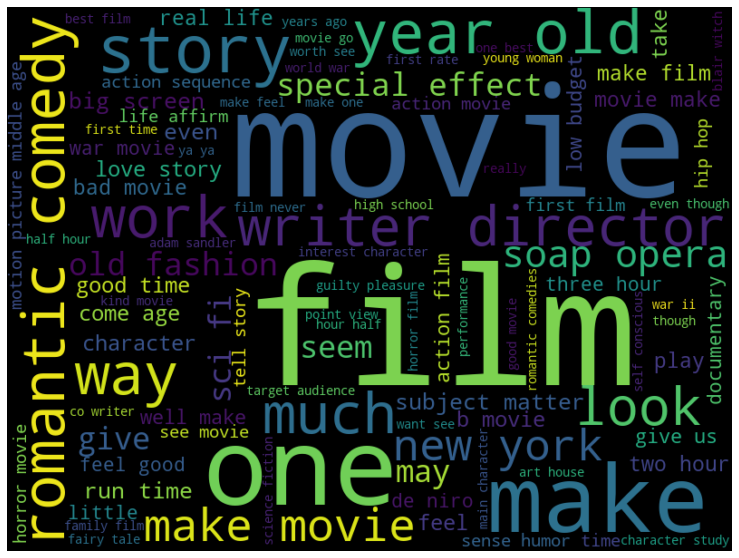

In [37]:
processed_text = [(' '.join(sentence)) for sentence in tokens_custom_cleaned_and_without_stopwords_and_lemmatized]
whole_reviews = ' '.join(processed_text)


# Create and generate a word cloud image:
wordcloud = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

# Display the generated image:
plt.figure( figsize=(20,10) )
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

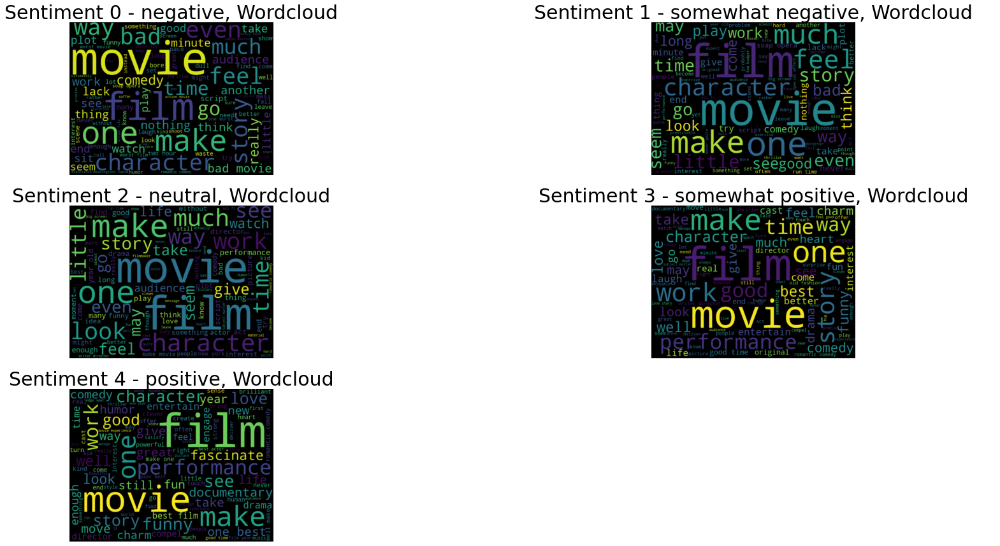

In [38]:
#np.shape(processed_text)
processed_df = pd.DataFrame(columns=["Phrase", "Sentiment"])
processed_df.Phrase = processed_text
processed_df.Sentiment = df.Sentiment.values


fig,axes = plt.subplots(3, 2, figsize=(30, 15))

temp = processed_df[processed_df.Sentiment == 0].Phrase
whole_reviews = ' '.join(temp)

wordcloud_1 = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

ax = axes[0, 0]
ax.imshow(wordcloud_1, interpolation="bilinear")
ax.axis('off')
ax.set_title("Sentiment 0 - negative, Wordcloud", fontsize=30)

temp = processed_df[processed_df.Sentiment == 1].Phrase
whole_reviews = ' '.join(temp)

wordcloud_2 = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

ax = axes[0, 1]
ax.imshow(wordcloud_2, interpolation="bilinear")
ax.axis('off')
ax.set_title("Sentiment 1 - somewhat negative, Wordcloud", fontsize=30)

temp = processed_df[processed_df.Sentiment == 2].Phrase
whole_reviews = ' '.join(temp)

wordcloud_3 = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

ax = axes[1, 0]
ax.imshow(wordcloud_3, interpolation="bilinear")
ax.axis('off')
ax.set_title("Sentiment 2 - neutral, Wordcloud", fontsize=30)

temp = processed_df[processed_df.Sentiment == 3].Phrase
whole_reviews = ' '.join(temp)

wordcloud_4 = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

ax = axes[1, 1]
ax.imshow(wordcloud_4, interpolation="bilinear")
ax.axis('off')
ax.set_title("Sentiment 3 - somewhat positive, Wordcloud", fontsize=30)


temp = processed_df[processed_df.Sentiment == 4].Phrase
whole_reviews = ' '.join(temp)

wordcloud_5 = WordCloud(max_font_size=180, max_words=100, width=800, height=600).generate(whole_reviews)

ax = axes[2, 0]
ax.imshow(wordcloud_5, interpolation="bilinear")
ax.axis('off')
ax.set_title("Sentiment 4 - positive, Wordcloud", fontsize=30)


axes[-1, -1].axis('off')
plt.show()



In [39]:
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(tokens_custom_cleaned_and_without_stopwords_and_lemmatized).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']
#print(top_cleaned_words_df.head(10))

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [40]:
temp = tokenize_the_text(processed_df[processed_df.Sentiment == 0].Phrase)
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(temp).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning for sentiment 0')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [41]:
temp = tokenize_the_text(processed_df[processed_df.Sentiment == 1].Phrase)
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(temp).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning  for sentiment 1')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [42]:
temp = tokenize_the_text(processed_df[processed_df.Sentiment == 2].Phrase)
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(temp).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning  for sentiment 2')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [43]:
temp = tokenize_the_text(processed_df[processed_df.Sentiment == 3].Phrase)
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(temp).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning  for sentiment 3')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [44]:
temp = tokenize_the_text(processed_df[processed_df.Sentiment == 4].Phrase)
top_cleaned_words_df = pd.DataFrame()

top_cleaned_words_df = top_cleaned_words_df.append(list(sorted(get_word_count_dict(temp).items(), key=operator.itemgetter(1), reverse=True)))
top_cleaned_words_df.columns = ['word', 'frequency']

limit = 20

trace1 = go.Bar(
            x=top_cleaned_words_df.head(limit).word,
            y=top_cleaned_words_df.head(limit).frequency,
    marker=dict(
                color = top_cleaned_words_df.head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent words after cleaning for sentiment 4')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [45]:
bigram_dict = dict()
limit = 20

bigrm = list(nltk.bigrams(whole_reviews.split()))

for elem in bigrm:
    new_elem = ' '.join(elem)
    if new_elem not in bigram_dict:
        bigram_dict[new_elem] = 1
    else:
        bigram_dict[new_elem] += 1
        
    
top_cleaned_bigram_df = pd.DataFrame.from_dict(bigram_dict, orient='index', columns=["frequency"])
top_cleaned_bigram_df["bigram"] = top_cleaned_bigram_df.index 
top_cleaned_bigram_df = top_cleaned_bigram_df.reset_index(drop=True)
top_cleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit)


trace1 = go.Bar(
            y=top_cleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,
            x=top_cleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).bigram,
    marker=dict(
                color = top_cleaned_bigram_df.sort_values(ascending=False, by="frequency").head(limit).frequency,colorscale='Cividis',showscale=True,
                reversescale = False
                )
    )

layout = dict(title= 'Top '+str(limit)+' most frequent Bigrams after cleaning')
fig=dict(data=[trace1], layout=layout)
plotly.offline.iplot(fig)

In [46]:
trigram_dict = dict()


trigrm = list(nltk.trigrams(whole_reviews.split()))

for elem in trigrm:
    if elem not in bigram_dict:
        trigram_dict[elem] = 1
    else:
        trigram_dict[elem] += 1

top_cleaned_trigram_df = pd.DataFrame.from_dict(trigram_dict, orient='index', columns=["frequency"])
top_cleaned_trigram_df["trigram"] = top_cleaned_trigram_df.index 
top_cleaned_trigram_df = top_cleaned_trigram_df.reset_index(drop=True)
top_cleaned_trigram_df.sort_values(ascending=False, by="frequency").head(10)


,frequency,trigram
0,1,"(quiet, introspective, entertain)"
20947,1,"(kidman, make, party)"
20945,1,"(drama, nicole, kidman)"
20944,1,"(crime, drama, nicole)"
20943,1,"(drama, satisfy, crime)"
20942,1,"(crime, drama, satisfy)"
20941,1,"(drama, add, satisfy)"
20940,1,"(crime, drama, add)"
20939,1,"(drama, cat, mouse)"
20938,1,"(crime, drama, cat)"


In [47]:
def get_ne_dict(tokens):
    
    from collections import defaultdict
    ne_dict = defaultdict(list)
    
    for sent in tokens_custom_cleaned_and_without_stopwords_and_lemmatized:
        for entity in nltk.ne_chunk(nltk.pos_tag(sent), binary=False):
            if len(entity) != 2:
                ne_dict[entity.label()].append(entity[0][0])
            
                
    return ne_dict

import operator

ne_dict = get_ne_dict(tokens_custom_cleaned_and_without_stopwords_and_lemmatized)

In [48]:
for elem in ne_dict.items():
    print(elem[0],":", set(elem[1]))

ORGANIZATION : {'u.n.'}
PERSON : {'mr.'}
GPE : {'a.s.', 'u.s.', 'u.s'}


In [49]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text = [(' '.join(sentence)) for sentence in tokens_custom_cleaned_and_without_stopwords_and_lemmatized]
vz = vectorizer.fit_transform(processed_text)

In [50]:
tfidf = dict(zip(vectorizer.get_feature_names(), vectorizer.idf_))
tfidf = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf), orient='index')
tfidf.columns = ['tfidf']

tfidf.sort_values(by=['tfidf'], ascending=True).head(10)

,tfidf
film,4.003974
movie,4.238848
make,4.644150
one,4.744892
like,4.867906
character,4.990722
story,5.125591
time,5.131160
good,5.262244
work,5.331919


In [51]:
tfidf.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
zzzzzzzzz,11.166243
go silly,11.166243
pleasure sensuality,11.166243
pleasures familiar,11.166243
good achingly,11.166243
gondry direction,11.166243
plenty offend,11.166243
plenty scenes,11.166243
plenty shake,11.166243
create adventure,11.166243


### TF - IDF vectorizer per Sentiment  - ** Sentiment 0 - Negative **

In [52]:
temp_tokens = tokenize_the_text(processed_df[processed_df.Sentiment == 0].Phrase)

from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer_sent = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text_sent = [(' '.join(sentence)) for sentence in temp_tokens]
vz_sent = vectorizer_sent.fit_transform(processed_text_sent)

tfidf_sent = dict(zip(vectorizer_sent.get_feature_names(), vectorizer_sent.idf_))
tfidf_sent = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf_sent), orient='index')
tfidf_sent.columns = ['tfidf']

tfidf_sent.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
long shelf,8.072281
lame kiddie,8.072281
know steven,8.072281
king brown,8.072281
kind film,8.072281
kick,8.072281
keen,8.072281
juvenile,8.072281
junk tv,8.072281
jumble,8.072281


### TF - IDF vectorizer per Sentiment  - ** Sentiment 1 - somewhat negative **

In [53]:
temp_tokens = tokenize_the_text(processed_df[processed_df.Sentiment == 1].Phrase)

from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer_sent = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text_sent = [(' '.join(sentence)) for sentence in temp_tokens]
vz_sent = vectorizer_sent.fit_transform(processed_text_sent)

tfidf_sent = dict(zip(vectorizer_sent.get_feature_names(), vectorizer_sent.idf_))
tfidf_sent = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf_sent), orient='index')
tfidf_sent.columns = ['tfidf']

tfidf_sent.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
grandiloquent end,9.42193
supernatural,9.42193
harsh reality,9.42193
harsh conceptual,9.42193
superfluous sequel,9.42193
harry tonto,9.42193
harry potter,9.42193
hardly fun,9.42193
hardly distinguish,9.42193
hard tell,9.42193


### TF - IDF vectorizer per Sentiment  - ** Sentiment 2 - Neutral ** 

In [54]:
temp_tokens = tokenize_the_text(processed_df[processed_df.Sentiment == 2].Phrase)

from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer_sent = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text_sent = [(' '.join(sentence)) for sentence in temp_tokens]
vz_sent = vectorizer_sent.fit_transform(processed_text_sent)

tfidf_sent = dict(zip(vectorizer_sent.get_feature_names(), vectorizer_sent.idf_))
tfidf_sent = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf_sent), orient='index')
tfidf_sent.columns = ['tfidf']

tfidf_sent.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
discipline grade,10.492796
genre definitive,10.492796
neo augustinian,10.492796
neil finn,10.492796
genres exist,10.492796
negative,10.492796
genteel prep,10.492796
countenance,10.492796
shadowy black,10.492796
needy margot,10.492796


### TF - IDF vectorizer per Sentiment  - ** Sentiment 3 - Somewhat Positive **

In [55]:
temp_tokens = tokenize_the_text(processed_df[processed_df.Sentiment == 3].Phrase)

from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer_sent = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text_sent = [(' '.join(sentence)) for sentence in temp_tokens]
vz_sent = vectorizer_sent.fit_transform(processed_text_sent)

tfidf_sent = dict(zip(vectorizer_sent.get_feature_names(), vectorizer_sent.idf_))
tfidf_sent = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf_sent), orient='index')
tfidf_sent.columns = ['tfidf']

tfidf_sent.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
prove never,9.610319
operate nicely,9.610319
ooze attractive,9.610319
open premise,9.610319
open vein,9.610319
opera reside,9.610319
dramatically satisfy,9.610319
dramatic unity,9.610319
dramatic performance,9.610319
drama black,9.610319


### TF - IDF vectorizer per Sentiment  - ** Sentiment 4 - Positive **

In [56]:
temp_tokens = tokenize_the_text(processed_df[processed_df.Sentiment == 4].Phrase)

from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer_sent = TfidfVectorizer(min_df=5, lowercase=True, ngram_range=(1, 2))


processed_text_sent = [(' '.join(sentence)) for sentence in temp_tokens]
vz_sent = vectorizer_sent.fit_transform(processed_text_sent)

tfidf_sent = dict(zip(vectorizer_sent.get_feature_names(), vectorizer_sent.idf_))
tfidf_sent = pd.DataFrame(columns=['tfidf']).from_dict(
                    dict(tfidf_sent), orient='index')
tfidf_sent.columns = ['tfidf']

tfidf_sent.sort_values(by=['tfidf'], ascending=False).head(10)

,tfidf
psychology order,8.33596
film truly,8.33596
project script,8.33596
pronounce,8.33596
davis,8.33596
pronounce monty,8.33596
film theme,8.33596
grace call,8.33596
date hong,8.33596
purer,8.33596


In [57]:
from sklearn.decomposition import TruncatedSVD

n_comp=30
svd = TruncatedSVD(n_components=n_comp, random_state=42)
svd_tfidf = svd.fit_transform(vz)

In [58]:
'''
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)
    print(device)
'''

"\nimport os\nos.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' \nimport tensorflow as tf\ngpu_devices = tf.config.experimental.list_physical_devices('GPU')\nfor device in gpu_devices:\n    tf.config.experimental.set_memory_growth(device, True)\n    print(device)\n"

In [59]:
from sklearn.manifold import TSNE

tsne_model = TSNE(n_components=2, verbose=1, random_state=42, n_iter=500)
tsne_tfidf = tsne_model.fit_transform(svd_tfidf)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 156060 samples in 0.006s...
[t-SNE] Computed neighbors for 156060 samples in 1315.864s...
[t-SNE] Computed conditional probabilities for sample 1000 / 156060
[t-SNE] Computed conditional probabilities for sample 2000 / 156060
[t-SNE] Computed conditional probabilities for sample 3000 / 156060
[t-SNE] Computed conditional probabilities for sample 4000 / 156060
[t-SNE] Computed conditional probabilities for sample 5000 / 156060
[t-SNE] Computed conditional probabilities for sample 6000 / 156060
[t-SNE] Computed conditional probabilities for sample 7000 / 156060
[t-SNE] Computed conditional probabilities for sample 8000 / 156060
[t-SNE] Computed conditional probabilities for sample 9000 / 156060
[t-SNE] Computed conditional probabilities for sample 10000 / 156060
[t-SNE] Computed conditional probabilities for sample 11000 / 156060
[t-SNE] Computed conditional probabilities for sample 12000 / 156060
[t-SNE] Computed conditional prob

[t-SNE] Computed conditional probabilities for sample 118000 / 156060
[t-SNE] Computed conditional probabilities for sample 119000 / 156060
[t-SNE] Computed conditional probabilities for sample 120000 / 156060
[t-SNE] Computed conditional probabilities for sample 121000 / 156060
[t-SNE] Computed conditional probabilities for sample 122000 / 156060
[t-SNE] Computed conditional probabilities for sample 123000 / 156060
[t-SNE] Computed conditional probabilities for sample 124000 / 156060
[t-SNE] Computed conditional probabilities for sample 125000 / 156060
[t-SNE] Computed conditional probabilities for sample 126000 / 156060
[t-SNE] Computed conditional probabilities for sample 127000 / 156060
[t-SNE] Computed conditional probabilities for sample 128000 / 156060
[t-SNE] Computed conditional probabilities for sample 129000 / 156060
[t-SNE] Computed conditional probabilities for sample 130000 / 156060
[t-SNE] Computed conditional probabilities for sample 131000 / 156060
[t-SNE] Computed con

### Train set reviews’ visualization over the 2-axis using t-SNE.

In [3]:
'''
plot_df = pd.DataFrame(columns=["x", "y", "text"])
plot_df.x = tsne_tfidf[:,0]
plot_df.y = tsne_tfidf[:,1]
plot_df.text = processed_text

source = ColumnDataSource(data=dict(x=plot_df['x'], y=plot_df['y'],
                                    text=plot_df['text']))


plot_tfidf = figure(plot_width=700, plot_height=600,
                        title="Tf-IDF text to features representation using tSNE",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

plot_tfidf.scatter(source = source, x='x', y='y', color='#4286f4')
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"text": "@text" }
output_file("Train_set_reviews_visualization_over_the_2-axis_using_t-SNE.html")
show(plot_tfidf)
'''

'\nplot_df = pd.DataFrame(columns=["x", "y", "text"])\nplot_df.x = tsne_tfidf[:,0]\nplot_df.y = tsne_tfidf[:,1]\nplot_df.text = processed_text\n\nsource = ColumnDataSource(data=dict(x=plot_df[\'x\'], y=plot_df[\'y\'],\n                                    text=plot_df[\'text\']))\n\n\nplot_tfidf = figure(plot_width=700, plot_height=600,\n                        title="Tf-IDF text to features representation using tSNE",\n    tools="pan,wheel_zoom,box_zoom,reset,hover",\n    x_axis_type=None, y_axis_type=None, min_border=1)\n\nplot_tfidf.scatter(source = source, x=\'x\', y=\'y\', color=\'#4286f4\')\nhover = plot_tfidf.select(dict(type=HoverTool))\nhover.tooltips={"text": "@text" }\noutput_file("Train_set_reviews_visualization_over_the_2-axis_using_t-SNE.html")\nshow(plot_tfidf)\n'

### Kmeans grid search
Find the optimal number of clusters and evaluate clustering via silhouette score.

In [62]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import MiniBatchKMeans


range_n_clusters = [6, 8, 10, 12, 14, 16, 18]

cluster_grid_df = pd.DataFrame(columns=["cluster_size", "silhouette_score"])

for num_clusters in range_n_clusters:
    
    kmeans_model = MiniBatchKMeans(n_clusters=num_clusters,
                               init='k-means++',
                               n_init=1,
                               init_size=1000, batch_size=1000, verbose=0, max_iter=1000, random_state=42)

    kmeans = kmeans_model.fit(vz)
    kmeans_clusters = kmeans.predict(vz)
    silhouette_avg = silhouette_score(vz, kmeans_clusters)
    print("For n_clusters =", num_clusters, "The average silhouette_score is :", silhouette_avg)
    cluster_grid_df = cluster_grid_df.append({'cluster_size': num_clusters, 'silhouette_score': silhouette_avg}, ignore_index=True)

For n_clusters = 6 The average silhouette_score is : 0.0032224367841873847
For n_clusters = 8 The average silhouette_score is : 0.0034361563708405953
For n_clusters = 10 The average silhouette_score is : 0.002276346452562802
For n_clusters = 12 The average silhouette_score is : 0.00377185231739065
For n_clusters = 14 The average silhouette_score is : 0.002771378918097593
For n_clusters = 16 The average silhouette_score is : 0.0022496561463954644
For n_clusters = 18 The average silhouette_score is : 0.002069803909169285


In [63]:
num_clusters = int(cluster_grid_df[np.abs(cluster_grid_df.silhouette_score) == np.max(cluster_grid_df.silhouette_score)].cluster_size)


kmeans_model = MiniBatchKMeans(n_clusters=num_clusters,
                               init='k-means++',
                               n_init=1,
                               init_size=1000, batch_size=1000, verbose=0, max_iter=1000, random_state=42)

kmeans = kmeans_model.fit(vz)
kmeans_clusters = kmeans.predict(vz)
kmeans_distances = kmeans.transform(vz)

### Representative terms per cluster center (cluster center)

In [64]:
num_clusters = int(cluster_grid_df[np.abs(cluster_grid_df.silhouette_score) == np.max(cluster_grid_df.silhouette_score)].cluster_size)

print("Representative terms per cluster center:")
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()
for i in range(num_clusters):
    print("Cluster %d:" % i)
    center_cluster_str_words = []
    for ind in order_centroids[i, :10]:
        str = "".join(terms[ind])
        center_cluster_str_words.append(str)
    print(' %s' % "|".join(center_cluster_str_words))
    print()

Representative terms per cluster center:
Cluster 0:
 heartfelt hilarious|heartfelt|hilarious|flick art|flick examine|flick ever|flick even|flick emulate|flick day|flick core

Cluster 1:
 one|character|time|story|like|good|work|much|see|comedy

Cluster 2:
 winner|zzzzzzzzz|flick antonio|flick ever|flick even|flick emulate|flick day|flick core|flick college|flick cliches

Cluster 3:
 make|movie|film|make movie|well make|well|movies|make film|like|one

Cluster 4:
 trial crimes|crimes humanity|trial|crimes|humanity|flim flam|flick 1970s|flick day|flick core|flick college

Cluster 5:
 movie|bad|one|bad movie|like|see|action movie|good|action|good movie

Cluster 6:
 concern self|self preservation|preservation|concern|self|zzzzzzzzz|flick emulate|flick day|flick core|flick college

Cluster 7:
 commentary enough|commentary|enough|zzzzzzzzz|flick art|flick ever|flick even|flick emulate|flick day|flick core

Cluster 8:
 film|one|good|good film|first|like|best|see|action film|best film

Cluster 9

In [65]:
from sklearn.manifold import TSNE
tsne_model = TSNE(n_components=2, verbose=1, init='pca', random_state=42, n_iter=500)

tsne_kmeans = tsne_model.fit_transform(kmeans_distances)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 156060 samples in 89.449s...
[t-SNE] Computed neighbors for 156060 samples in 261.610s...
[t-SNE] Computed conditional probabilities for sample 1000 / 156060
[t-SNE] Computed conditional probabilities for sample 2000 / 156060
[t-SNE] Computed conditional probabilities for sample 3000 / 156060
[t-SNE] Computed conditional probabilities for sample 4000 / 156060
[t-SNE] Computed conditional probabilities for sample 5000 / 156060
[t-SNE] Computed conditional probabilities for sample 6000 / 156060
[t-SNE] Computed conditional probabilities for sample 7000 / 156060
[t-SNE] Computed conditional probabilities for sample 8000 / 156060
[t-SNE] Computed conditional probabilities for sample 9000 / 156060
[t-SNE] Computed conditional probabilities for sample 10000 / 156060
[t-SNE] Computed conditional probabilities for sample 11000 / 156060
[t-SNE] Computed conditional probabilities for sample 12000 / 156060
[t-SNE] Computed conditional prob

[t-SNE] Computed conditional probabilities for sample 123000 / 156060
[t-SNE] Computed conditional probabilities for sample 124000 / 156060
[t-SNE] Computed conditional probabilities for sample 125000 / 156060
[t-SNE] Computed conditional probabilities for sample 126000 / 156060
[t-SNE] Computed conditional probabilities for sample 127000 / 156060
[t-SNE] Computed conditional probabilities for sample 128000 / 156060
[t-SNE] Computed conditional probabilities for sample 129000 / 156060
[t-SNE] Computed conditional probabilities for sample 130000 / 156060
[t-SNE] Computed conditional probabilities for sample 131000 / 156060
[t-SNE] Computed conditional probabilities for sample 132000 / 156060
[t-SNE] Computed conditional probabilities for sample 133000 / 156060
[t-SNE] Computed conditional probabilities for sample 134000 / 156060
[t-SNE] Computed conditional probabilities for sample 135000 / 156060
[t-SNE] Computed conditional probabilities for sample 136000 / 156060
[t-SNE] Computed con

In [67]:

colormap = np.array([
    "#000080", "#00BFFF", "#008000", "#808000", "#FF8C00",
    "#FF7F50", "#4ba04e", "#FF6347", "#A9A9A9", "#808080",
    "#ADD8E6", "#FF00FF", "#90EE90", "#C0C0C0", "#FF00FF",
    "#008080", "#4169E1", "#BDB76B", "#F0FFF0", "#F4A460",
    "#4B0082", "#FA8072", "#9ACD32", "#7CFC00", "#DDA0DD",
    "#A52A2A", "#F5F5DC", "#FFEFD5", "#008080", "#000000"
])


plot_df = pd.DataFrame(columns=["x", "y", "text", "cluster"])
plot_df.x = tsne_kmeans[:,0]
plot_df.y = tsne_kmeans[:,1]
plot_df.text = processed_text
plot_df.cluster = kmeans_clusters

source = ColumnDataSource(data=dict(x=plot_df['x'], y=plot_df['y'],
                                    cluster=plot_df['cluster'],
                                    color=colormap[kmeans_clusters],
                                    text=plot_df['text']))


plot_kmeans = figure(plot_width=700, plot_height=600,
                        title="KMeans clustering of the description",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

plot_kmeans.scatter(source = source, x='x', y='y', color='color')
hover = plot_kmeans.select(dict(type=HoverTool))
hover.tooltips={"text": "@text", "cluster":"@cluster" }
output_file("K-means_reviews_clustering_t-SNE_vizualization.html")
show(plot_kmeans)

In [68]:
from sklearn.feature_extraction.text import CountVectorizer

cvectorizer = CountVectorizer(min_df=5, lowercase=True, ngram_range=(1,2))

processed_text = [(' '.join(sentence)) for sentence in tokens_custom_cleaned_and_without_stopwords_and_lemmatized]
cvz = cvectorizer.fit_transform(processed_text)

In [69]:
from sklearn.decomposition import LatentDirichletAllocation

# Define Search Param
list_of_components= [6,8,10,12]

lda_grid_df = pd.DataFrame(columns=["components", "perplexity", "log_likelihood"])

for components in list_of_components:
    
    lda_model = LatentDirichletAllocation(n_components=components, max_iter=20, learning_method='online', random_state=42)
    X_topics = lda_model.fit_transform(cvz)
    print("number of components: ", components)
    print("perplexity: ", lda_model.perplexity(cvz))
    print("log likelihood score: ", lda_model.score(cvz))
    print()
    
    lda_grid_df = lda_grid_df.append({'components': components, 'perplexity': lda_model.perplexity(cvz), "log_likelihood": lda_model.score(cvz)}, ignore_index=True)

number of components:  6
perplexity:  17448.75131080484
log likelihood score:  -10110793.288396645

number of components:  8
perplexity:  16874.25519704259
log likelihood score:  -10076135.93977799

number of components:  10
perplexity:  16252.285813046356
log likelihood score:  -10037258.562600724

number of components:  12
perplexity:  15814.621626901398
log likelihood score:  -10008999.099841697



In [70]:
from sklearn.decomposition import LatentDirichletAllocation

n_topics = 12
n_iter = 20 # number of iterations

lda_model = LatentDirichletAllocation(n_components=n_topics,
                                      learning_method='online',
                                      max_iter=n_iter,
                                      random_state=42)

X_topics = lda_model.fit_transform(cvz)

Lets view top keywords per topic

In [71]:
n_top_words = 10
topic_summaries = []

topic_word = lda_model.components_  # get the topic words
vocab = cvectorizer.get_feature_names()

for i, topic_dist in enumerate(topic_word):
    topic_words = np.array(vocab)[np.argsort(topic_dist)][:-(n_top_words+1):-1]
    topic_summaries.append(' '.join(topic_words))
    print('Topic {}: {}'.format(i, ' | '.join(topic_words)))

Topic 0: movie | story | love | interest | minutes | hollywood | entertain | less | need | set
Topic 1: film | go | little | give | never | may | could | human | young | emotional
Topic 2: one | time | plot | watch | old | another | hard | bite | right | material
Topic 3: good | director | us | something | many | cast | sense | humor | want | laugh
Topic 4: make | see | movie | would | one | without | ever | nothing | long | kind
Topic 5: get | feel | well | movies | best | first | try | year | show | know
Topic 6: character | work | comedy | funny | bad | world | drama | screen | big | charm
Topic 7: people | think | play | leave | kid | often | might | things | moments | face
Topic 8: like | look | enough | end | seem | self | live | still | run | move
Topic 9: life | come | act | action | two | really | every | man | great | real
Topic 10: much | new | audience | better | family | script | performance | heart | cinema | full
Topic 11: even | way | take | find | turn | back | keep | 

In [72]:
# reduce dimension to 2 using tsne
from sklearn.manifold import TSNE
tsne_model = TSNE(n_components=2, verbose=1, init='pca', random_state=42, n_iter=500)
tsne_lda = tsne_model.fit_transform(X_topics)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 156060 samples in 0.374s...
[t-SNE] Computed neighbors for 156060 samples in 79.043s...
[t-SNE] Computed conditional probabilities for sample 1000 / 156060
[t-SNE] Computed conditional probabilities for sample 2000 / 156060
[t-SNE] Computed conditional probabilities for sample 3000 / 156060
[t-SNE] Computed conditional probabilities for sample 4000 / 156060
[t-SNE] Computed conditional probabilities for sample 5000 / 156060
[t-SNE] Computed conditional probabilities for sample 6000 / 156060
[t-SNE] Computed conditional probabilities for sample 7000 / 156060
[t-SNE] Computed conditional probabilities for sample 8000 / 156060
[t-SNE] Computed conditional probabilities for sample 9000 / 156060
[t-SNE] Computed conditional probabilities for sample 10000 / 156060
[t-SNE] Computed conditional probabilities for sample 11000 / 156060
[t-SNE] Computed conditional probabilities for sample 12000 / 156060
[t-SNE] Computed conditional probab

[t-SNE] Computed conditional probabilities for sample 124000 / 156060
[t-SNE] Computed conditional probabilities for sample 125000 / 156060
[t-SNE] Computed conditional probabilities for sample 126000 / 156060
[t-SNE] Computed conditional probabilities for sample 127000 / 156060
[t-SNE] Computed conditional probabilities for sample 128000 / 156060
[t-SNE] Computed conditional probabilities for sample 129000 / 156060
[t-SNE] Computed conditional probabilities for sample 130000 / 156060
[t-SNE] Computed conditional probabilities for sample 131000 / 156060
[t-SNE] Computed conditional probabilities for sample 132000 / 156060
[t-SNE] Computed conditional probabilities for sample 133000 / 156060
[t-SNE] Computed conditional probabilities for sample 134000 / 156060
[t-SNE] Computed conditional probabilities for sample 135000 / 156060
[t-SNE] Computed conditional probabilities for sample 136000 / 156060
[t-SNE] Computed conditional probabilities for sample 137000 / 156060
[t-SNE] Computed con

Now it is time to visualize the topics in the 2-axis using t-SNE

In [74]:
plot_df = pd.DataFrame(columns=["x", "y", "text", "topic"])
plot_df.x = tsne_lda[:,0]
plot_df.y = tsne_lda[:,1]
plot_df.text = processed_text
plot_df.topic = X_topics.argmax(axis=1)

colormap = np.array([
    "#000080", "#00BFFF", "#008000", "#808000", "#FF8C00",
    "#FF7F50", "#a368a3", "#FF6347", "#A9A9A9", "#808080",
    "#ADD8E6", "#FF00FF", "#90EE90", "#C0C0C0", "#FF00FF",
    "#008080", "#4169E1", "#BDB76B", "#F0FFF0", "#F4A460",
    "#4B0082", "#FA8072", "#9ACD32", "#7CFC00", "#DDA0DD",
    "#A52A2A", "#F5F5DC", "#FFEFD5", "#008080", "#000000"
])

source = ColumnDataSource(data=dict(x=plot_df['x'], y=plot_df['y'],
                                    topic=plot_df['topic'],
                                    color=colormap[plot_df['topic']],
                                    text=plot_df['text']))


plot_lda = figure(plot_width=700, plot_height=600,
                        title="LDA Topic Visualization",
    tools="pan,wheel_zoom,box_zoom,reset,hover",
    x_axis_type=None, y_axis_type=None, min_border=1)

plot_lda.scatter(source = source, x='x', y='y', color='color')
hover = plot_lda.select(dict(type=HoverTool))
hover.tooltips={"text": "@text", "topic":"@topic" }
output_file("LDA_and_tSNE_visualization.html")
show(plot_lda)

## Word Embeddings over the words in the Train Set using word2vec and tSNE

In [76]:
!pip install gensim

     |████████████████████████████████| 24.1 MB 2.2 MB/s eta 0:00:01
     |████████████████████████████████| 58 kB 2.6 MB/s eta 0:00:01


In [84]:
import gensim

sentences = [' '.join(sent) for sent in tokens_custom_cleaned_and_without_stopwords_and_lemmatized]

# Creating the model and setting values for the various parameters
num_features = 300  # Word vector dimensionality
min_word_count = 10 # Minimum word count
num_workers = 4     # Number of parallel threads
context = 5        # Context window size

# Initializing the train model
from gensim.models import word2vec


print("Training model....")
model = word2vec.Word2Vec(tokens_custom_cleaned_and_without_stopwords_and_lemmatized,
                          workers=num_workers,
                          vector_size=num_features,
                          min_count=min_word_count,
                          window=context)

# To make the model memory efficient
model.init_sims(replace=True)

Training model....


/tmp/ipykernel_5357/743773062.py:23: DeprecationWarning:

Call to deprecated `init_sims` (Gensim 4.0.0 implemented internal optimizations that make calls to init_sims() unnecessary. init_sims() is now obsoleted and will be completely removed in future versions. See https://github.com/RaRe-Technologies/gensim/wiki/Migrating-from-Gensim-3.x-to-4).



In [85]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

print("Top 4 similarities with positive cosine similarity")
print()

print("top 4 similar words for the word film:", model.wv.most_similar(positive=['film'], topn = 4))
print()

print("top 4 similar words for the word film:",model.wv.most_similar(positive=['great'], topn = 4))
print()

Top 4 similarities with positive cosine similarity

top 4 similar words for the word film: [('documentary', 0.6900942325592041), ('movie', 0.5981307029724121), ('swashbucklers', 0.5969246625900269), ('snobbery', 0.5952866077423096)]

top 4 similar words for the word film: [('list', 0.7189351916313171), ('apocalypse', 0.7169485092163086), ('major', 0.7055752277374268), ('terrific', 0.7006880044937134)]



### Convert from Word2vec and t-SNE to 2 and 3 dimensions and illustate the results in 2D and 3D respectively

In [88]:
from sklearn.manifold import TSNE

labels = []
w2v_vectors = []

for word in model.wv.key_to_index:
    w2v_vectors.append(model.wv[word])
    labels.append(word)

tsne_model = TSNE(n_components=2, init='pca', n_iter=500, random_state=42)
tsne_w2v = tsne_model.fit_transform(w2v_vectors)

In [1]:
'''
plotly.offline.init_notebook_mode(connected=True)

data = [go.Scatter(x=tsne_w2v[:,0], y=tsne_w2v[:,1], 
                   mode='markers', text = labels)]

fig = go.Figure(data=data, layout= go.Layout(title="Corpus Representation using Word2Vec and tSNE"))

iplot(fig, filename='2D_trainset_vocabulary_representation_using_w2v_and_tSNE')
'''

'\nplotly.offline.init_notebook_mode(connected=True)\n\ndata = [go.Scatter(x=tsne_w2v[:,0], y=tsne_w2v[:,1], \n                   mode=\'markers\', text = labels)]\n\nfig = go.Figure(data=data, layout= go.Layout(title="Corpus Representation using Word2Vec and tSNE"))\n\niplot(fig, filename=\'2D_trainset_vocabulary_representation_using_w2v_and_tSNE\')\n'

In [90]:
tsne_model = TSNE(n_components=3, init='pca', n_iter=500, random_state=42)
tsne_w2v_3d = tsne_model.fit_transform(w2v_vectors)

In [2]:
'''
data = [go.Scatter3d(x=tsne_w2v_3d[:,0], y=tsne_w2v_3d[:,1], z=tsne_w2v_3d[:,2], 
                   mode='markers', text = labels, 
                     marker = dict(size = 4, color = 'rgba(0, 10, 157, .6)'))]

fig = go.Figure(data=data, layout= go.Layout(title="3D Corpus Representation using Word2Vec and tSNE", autosize=False,
    width=900,
    height=900))

iplot(fig, filename='Corpus_representation_using_w2v_and_tSNE')
'''

'\ndata = [go.Scatter3d(x=tsne_w2v_3d[:,0], y=tsne_w2v_3d[:,1], z=tsne_w2v_3d[:,2], \n                   mode=\'markers\', text = labels, \n                     marker = dict(size = 4, color = \'rgba(0, 10, 157, .6)\'))]\n\nfig = go.Figure(data=data, layout= go.Layout(title="3D Corpus Representation using Word2Vec and tSNE", autosize=False,\n    width=900,\n    height=900))\n\niplot(fig, filename=\'Corpus_representation_using_w2v_and_tSNE\')\n'